In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns


In [2]:
%matplotlib inline

#### Loading the data 



In [3]:
train=pd.read_json('train.json')

In [4]:
train.head(20)

,bathrooms,bedrooms,building_id,created,description,display_address,features,interest_level,latitude,listing_id,longitude,manager_id,photos,price,street_address
10,1.5,3,53a5b119ba8f7b61d4e010512e0dfc85,2016-06-24 07:54:24,A Brand New 3 Bedroom 1.5 bath ApartmentEnjoy ...,Metropolitan Avenue,[],medium,40.7145,7211212,-73.9425,5ba989232d0489da1b5f2c45f6688adc,[https://photos.renthop.com/2/7211212_1ed4542e...,3000,792 Metropolitan Avenue
10000,1.0,2,c5c8a357cba207596b04d1afd1e4f130,2016-06-12 12:19:27,,Columbus Avenue,"[Doorman, Elevator, Fitness Center, Cats Allow...",low,40.7947,7150865,-73.9667,7533621a882f71e25173b27e3139d83d,[https://photos.renthop.com/2/7150865_be3306c5...,5465,808 Columbus Avenue
100004,1.0,1,c3ba40552e2120b0acfc3cb5730bb2aa,2016-04-17 03:26:41,"Top Top West Village location, beautiful Pre-w...",W 13 Street,"[Laundry In Building, Dishwasher, Hardwood Flo...",high,40.7388,6887163,-74.0018,d9039c43983f6e564b1482b273bd7b01,[https://photos.renthop.com/2/6887163_de85c427...,2850,241 W 13 Street
100007,1.0,1,28d9ad350afeaab8027513a3e52ac8d5,2016-04-18 02:22:02,Building Amenities - Garage - Garden - fitness...,East 49th Street,"[Hardwood Floors, No Fee]",low,40.7539,6888711,-73.9677,1067e078446a7897d2da493d2f741316,[https://photos.renthop.com/2/6888711_6e660cee...,3275,333 East 49th Street
100013,1.0,4,0,2016-04-28 01:32:41,Beautifully renovated 3 bedroom flex 4 bedroom...,West 143rd Street,[Pre-War],low,40.8241,6934781,-73.9493,98e13ad4b495b9613cef886d79a6291f,[https://photos.renthop.com/2/6934781_1fa4b41a...,3350,500 West 143rd Street
100014,2.0,4,38a913e46c94a7f46ddf19b756a9640c,2016-04-19 04:24:47,,West 18th Street,[],medium,40.7429,6894514,-74.0028,b209e2c4384a64cc307c26759ee0c651,[https://photos.renthop.com/2/6894514_9abb8592...,7995,350 West 18th Street
100016,1.0,2,3ba49a93260ca5df92fde024cb4ca61f,2016-04-27 03:19:56,Stunning unit with a great location and lots o...,West 107th Street,"[prewar, elevator, Dogs Allowed, Cats Allowed,...",low,40.8012,6930771,-73.9660,01287194f20de51872e81f660def4784,[https://photos.renthop.com/2/6930771_7e3622b6...,3600,210 West 107th Street
100020,2.0,1,0372927bcb6a0949613ef5bf893bbac7,2016-04-13 06:01:42,"This huge sunny ,plenty of lights 1 bed/2 bath...",West 21st Street,"[Doorman, Elevator, Pre-War, Terrace, Laundry ...",low,40.7427,6867392,-73.9957,e6472c7237327dd3903b3d6f6a94515a,[https://photos.renthop.com/2/6867392_b18283f6...,5645,155 West 21st Street
100026,1.0,1,a7efbeb58190aa267b4a9121cd0c88c0,2016-04-20 02:36:35,<p><a website_redacted,Hamilton Terrace,"[Cats Allowed, Dogs Allowed, Elevator, Laundry...",medium,40.8234,6898799,-73.9457,c1a6598437b7db560cde66e5a297a53f,[https://photos.renthop.com/2/6898799_3759be4c...,1725,63 Hamilton Terrace
100027,2.0,4,0,2016-04-02 02:58:15,This is a spacious four bedroom with every bed...,522 E 11th,"[Dishwasher, Hardwood Floors]",low,40.7278,6814332,-73.9808,23a01ea7717b38875f5b070282d1b9d2,[https://photos.renthop.com/2/6814332_e19a8552...,5800,522 E 11th


## How does the data look like?

There are Numerical,Text and Categorical variables in our data. Lets find out the number of rows and the number of columns. By looking below we find that there are around 50k rows and 15 columns. Now lets see what type of columns do we have in our dataset. We see that out of the 15 columns, 6 cols are numerical and 8 are object types or text types. The Target variable is 'interest_level' which is a categorical variable. Next we describe the variables through their min,max,mean,standard deviation

 Determining the number of rows and coumns

In [5]:
print("Total number of rows: ", train.shape[0])
print("Total number of columns: ",train.shape[1] )

Total number of rows:  49352
Total number of columns:  15


In [6]:
train.dtypes

bathrooms          float64
bedrooms             int64
building_id         object
created             object
description         object
display_address     object
features            object
interest_level      object
latitude           float64
listing_id           int64
longitude          float64
manager_id          object
photos              object
price                int64
street_address      object
dtype: object

In [5]:
train.describe()

,bathrooms,bedrooms,latitude,listing_id,longitude,price
count,49352.00000,49352.000000,49352.000000,4.935200e+04,49352.000000,4.935200e+04
mean,1.21218,1.541640,40.741545,7.024055e+06,-73.955716,3.830174e+03
std,0.50142,1.115018,0.638535,1.262746e+05,1.177912,2.206687e+04
min,0.00000,0.000000,0.000000,6.811957e+06,-118.271000,4.300000e+01
25%,1.00000,1.000000,40.728300,6.915888e+06,-73.991700,2.500000e+03
50%,1.00000,1.000000,40.751800,7.021070e+06,-73.977900,3.150000e+03
75%,1.00000,2.000000,40.774300,7.128733e+06,-73.954800,4.100000e+03
max,10.00000,8.000000,44.883500,7.753784e+06,0.000000,4.490000e+06


## How many listings for each of the three categories?

Now we look at our Target variable which is 'interest_level'. So by looking at the variable,there are three categories namely: Low, Medium and High. We can find out how many rows are there for each of the 3 categories

Low: 34284

Medium: 11229

high: 3839

In [7]:
target=train['interest_level']

In [8]:
target_counts=target.value_counts(dropna=False)

In [9]:
target_counts

low       34284
medium    11229
high       3839
Name: interest_level, dtype: int64

## How many listings per category?

The below barplot shows that category low has around 35k listings, medium has around 11k and high has around 3k

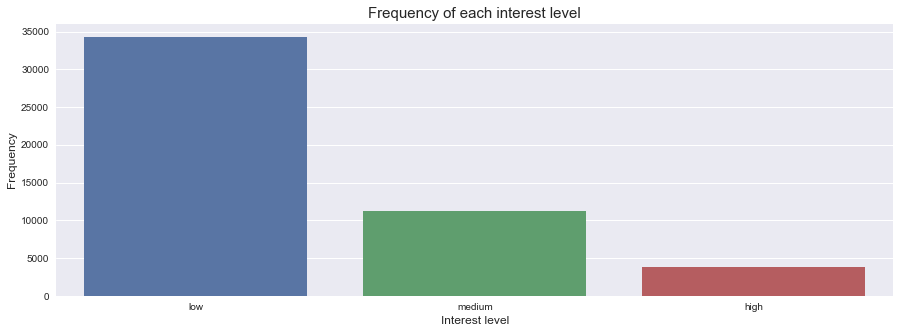

In [11]:
plt.figure(figsize=(15,5))
sns.barplot(target_counts.index,target_counts.values)
plt.title("Frequency of each interest level", fontsize=15)
plt.xlabel("Interest level", fontsize=12)
plt.ylabel("Frequency", fontsize=12)
plt.show()

## What are the numerical variables in the data?

In [12]:
numeric_data=train._get_numeric_data()

In [13]:
numeric_data.head()


,bathrooms,bedrooms,latitude,listing_id,longitude,price
10,1.5,3,40.7145,7211212,-73.9425,3000
10000,1.0,2,40.7947,7150865,-73.9667,5465
100004,1.0,1,40.7388,6887163,-74.0018,2850
100007,1.0,1,40.7539,6888711,-73.9677,3275
100013,1.0,4,40.8241,6934781,-73.9493,3350


### Analyzing Bathrooms

In [14]:
bathroom_counts=numeric_data['bathrooms'].value_counts()

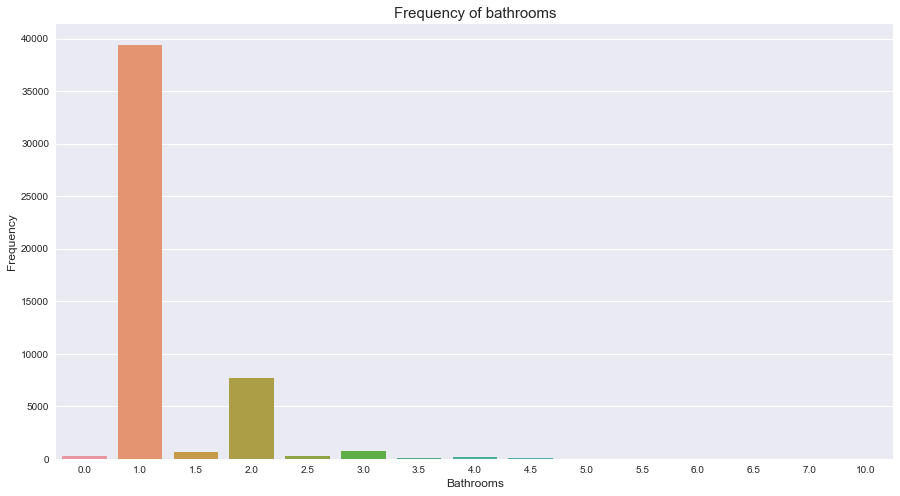

In [15]:
plt.figure(figsize=(15,8))
sns.barplot(bathroom_counts.index,bathroom_counts.values)
plt.title("Frequency of bathrooms", fontsize=15)
plt.ylabel("Frequency", fontsize=12)
plt.xlabel("Bathrooms", fontsize=12)
plt.show()

 From the Barplot, we see that apartments with only 1 bathroom has the highest number of listings, which is followed by 2 number of bathrooms

### Analyzing Bathrooms with the target variable 'Interest level'

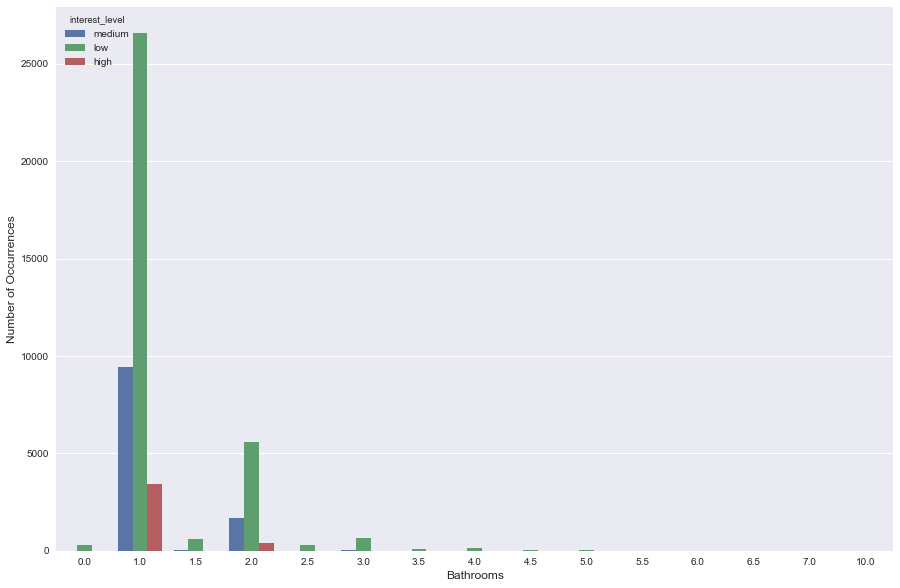

In [16]:
plt.figure(figsize=(15,10))
sns.countplot(x='bathrooms', hue='interest_level', data=train)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Bathrooms', fontsize=12)
plt.show()

From the countplot, we see that the listings with 1 bathroom has highest occurences with low interest levels among all other listings with other number of bathrooms. However form a countplot I am not able to detect outliers present. so I plot a strip plot


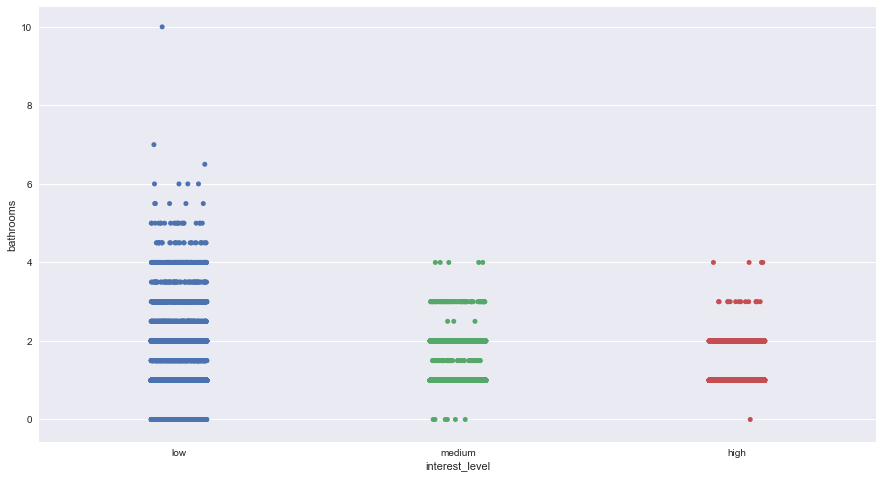

In [21]:
plt.figure(figsize=(15,8))
order = ['low', 'medium', 'high']
sns.stripplot(y="bathrooms", x="interest_level",data=train,jitter=True,order=order)

From the stripplot we see that one listing has 10 bathrooms,which can be considered as an outlier. We will therefore remove it.

In [22]:
ulimit = np.percentile(train.bathrooms.values, 99)
train['bathrooms'].ix[train['bathrooms']>ulimit] = ulimit

C:\Anaconda\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


Replotting the countplot plot for bathroomms after removing the outlier

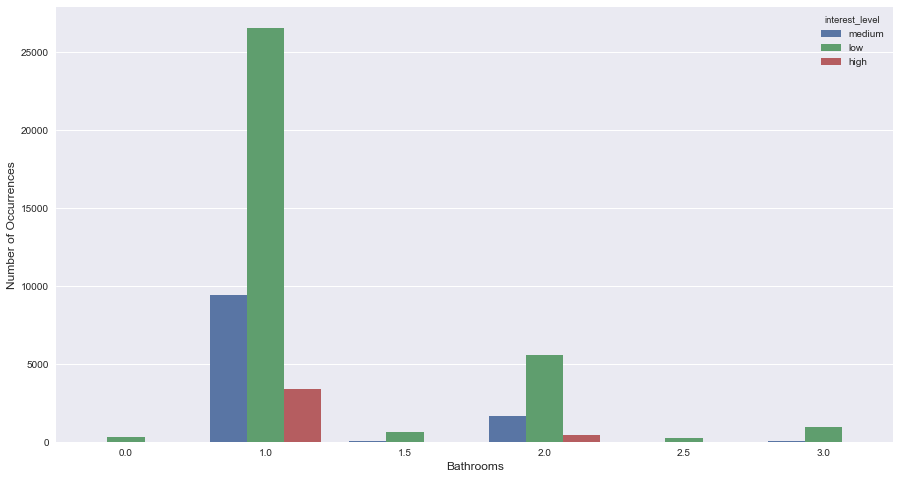

In [27]:
plt.figure(figsize=(15,8))
sns.countplot(x='bathrooms', hue='interest_level', data=train)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Bathrooms', fontsize=12)
plt.show()

### Analyzing Bedrooms

In [28]:
bedroom_count=numeric_data['bedrooms'].value_counts()

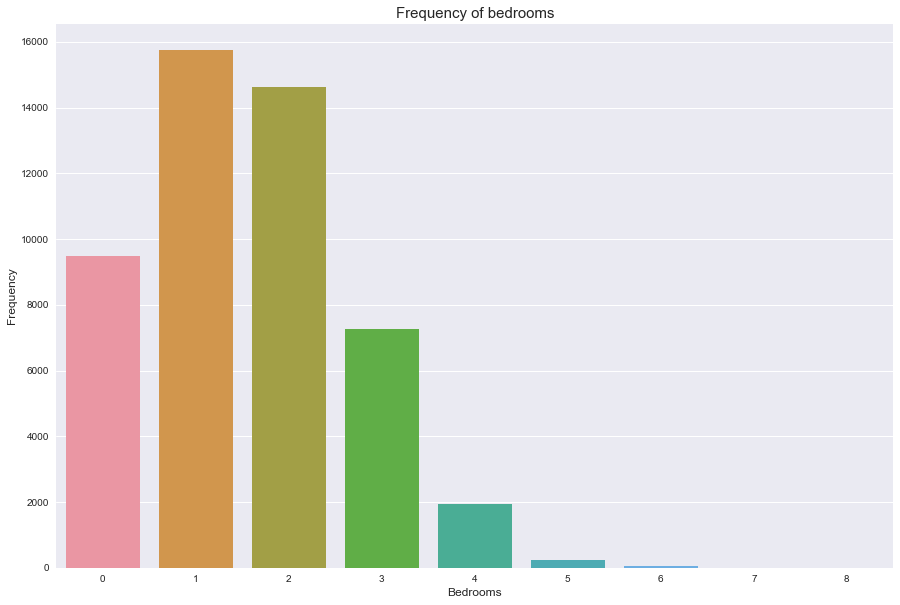

In [19]:
plt.figure(figsize=(15,10))
sns.barplot(bedroom_count.index,bedroom_count.values)
plt.title("Frequency of bedrooms", fontsize=15)
plt.ylabel("Frequency", fontsize=12)
plt.xlabel("Bedrooms", fontsize=12)
plt.show()

 From the barplot we see that apartment with 1 bedroom have the highest number of listings,followed by2 bedrooms and 3 bedrooms

### Analyzing Bedrooms with Target Variable 'interest_level'

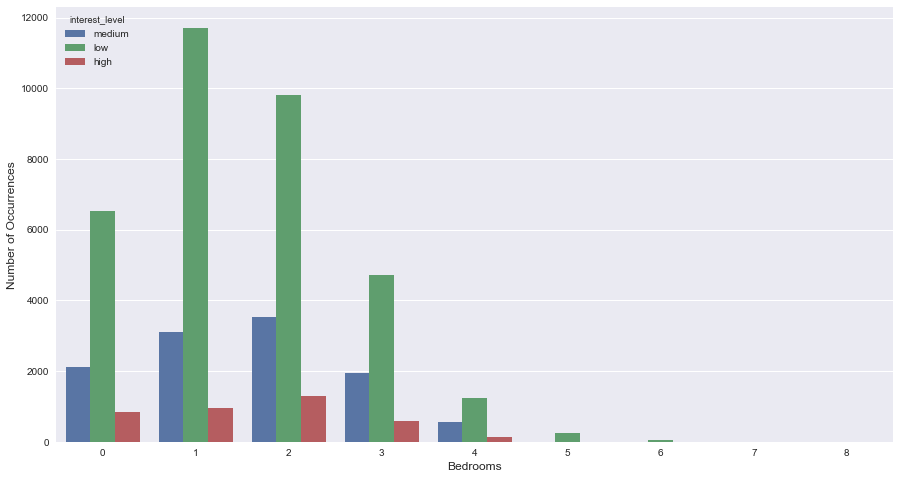

In [20]:
plt.figure(figsize=(15, 8))
sns.countplot(x='bedrooms', hue='interest_level', data=train)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Bedrooms', fontsize=12)
plt.show()

From the countplot,we see that apartments with 1 bedroom have the highest number of lisitings with interest level 'low'

In [54]:
train.groupby('interest_level').bedrooms.median()

interest_level
high      2
low       1
medium    2
Name: bedrooms, dtype: int64

We see that higher interest levels have 2 bedrooms listings, low has 1 and medium again has 2 bedrooms listings

### Analyzing Price

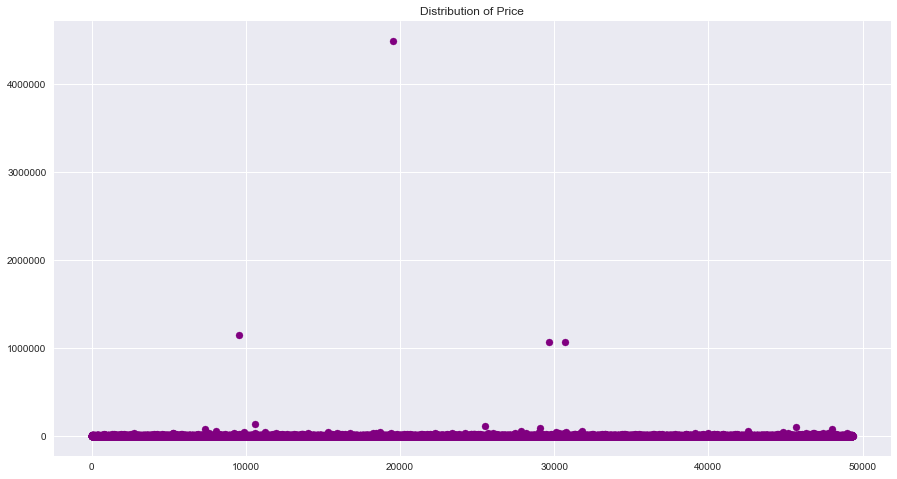

In [30]:
plt.figure(figsize=(15, 8))
plt.scatter(range(train.shape[0]), train["price"].values,color='purple')
plt.title("Distribution of Price");

By analyzing the price,we see that there are some outliers!. We therefore remove them

In [31]:
ulimit = np.percentile(train.price.values, 99)
train['price'].ix[train['price']>ulimit] = ulimit

C:\Anaconda\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


C:\Anaconda\lib\site-packages\statsmodels\nonparametric\kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


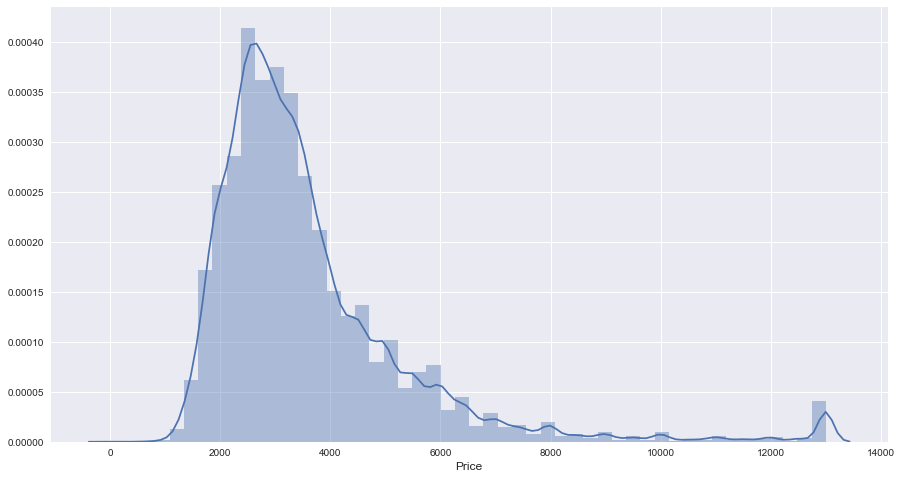

In [32]:
plt.figure(figsize=(15, 8))
sns.distplot(train['price'].values, bins=50, kde=True)
plt.xlabel('Price', fontsize=12)
plt.show()

From the above graph,we see that the distribution of Price is from around 1500$ to 13000$

### Analyzing Price with interest levels

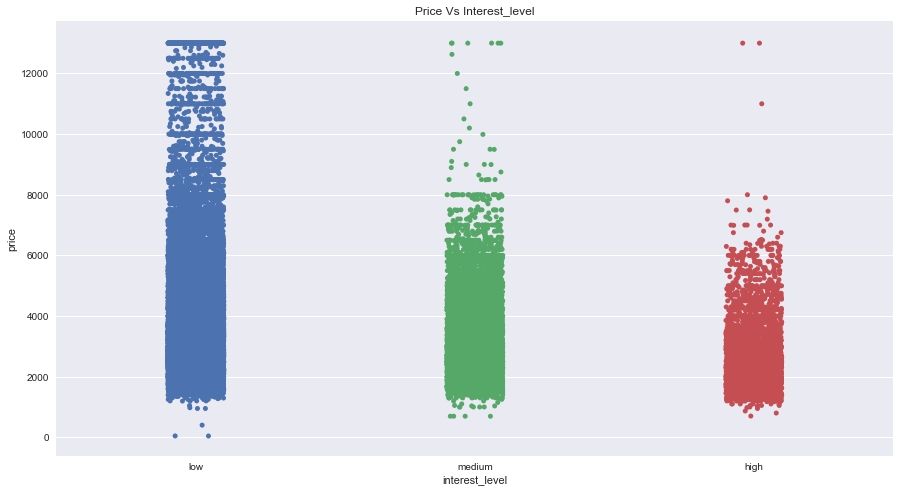

In [35]:
plt.figure(figsize=(15,8))
order = ['low', 'medium', 'high']
sns.stripplot(train["interest_level"],train["price"],jitter=True,order=order)
plt.title("Price Vs Interest_level");

We can see that majority of the listings with low interest levels have prices between 2000 to 8000 and  majority of listings with medium levels have prices between 1000 to 6500 and listings with high levels have prices between 1000 to 4500 dollars

In [53]:
train.groupby('interest_level').price.median()

interest_level
high      2400.0
low       3300.0
medium    2895.0
Name: price, dtype: float64

The high interest level has the lowest median price, the low interest level has the highest price. That is, the higher the price, the less interest it is.

### Analyzing Price with Bathrooms

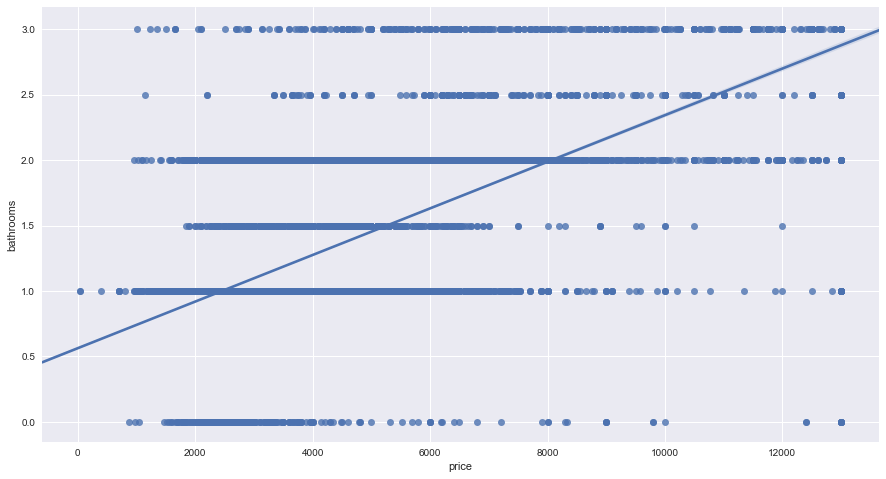

In [50]:
plt.figure(figsize=(15,8))
sns.regplot(y="bathrooms",x="price",data=train)

After removing the outliers for the price, we see that the number of bathrooms come down to 3.  From the graph, we see that there is no linear relation between bathrooms and price

#### Analyzing Price against Bedrooms

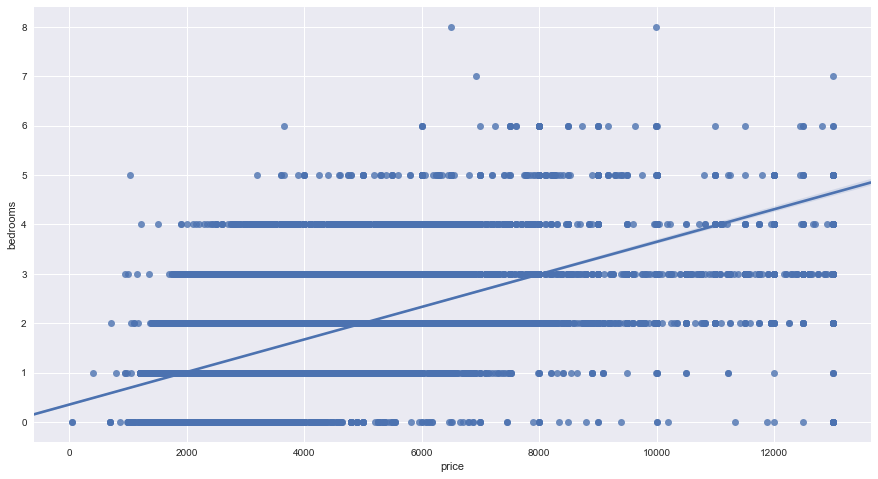

In [52]:
plt.figure(figsize=(15,8))
sns.regplot(y="bedrooms",x="price",data=train)

We see from the graph that there is no linear relationship between price and bedrooms

### Overall Analysis of Price,interest levels,bathrooms and bedrooms

In [58]:
train['pricetobedroom'] = train.price / train.bedrooms
train['pricetobathroom'] = train.price / train.bathrooms

print (train.ix[:, ['interest_level', 'price', 'bedrooms', 'bathrooms', 'pricetobedroom', 'pricetobathroom']]\
.groupby('interest_level').agg('median'))

                 price  bedrooms  bathrooms  pricetobedroom  pricetobathroom
interest_level                                                              
high            2400.0         2        1.0          1625.0           2300.0
low             3300.0         1        1.0          2700.0           2997.5
medium          2895.0         2        1.0          1887.5           2650.0


We conclude that highest interest level has lowest median price,has 2 bedrooms, 1 bathrooms. While the lowest interest level has highest median price,has 1 median bedroom ,1 median bathroom

### Analyzing Latitudes

C:\Anaconda\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\Anaconda\lib\site-packages\statsmodels\nonparametric\kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


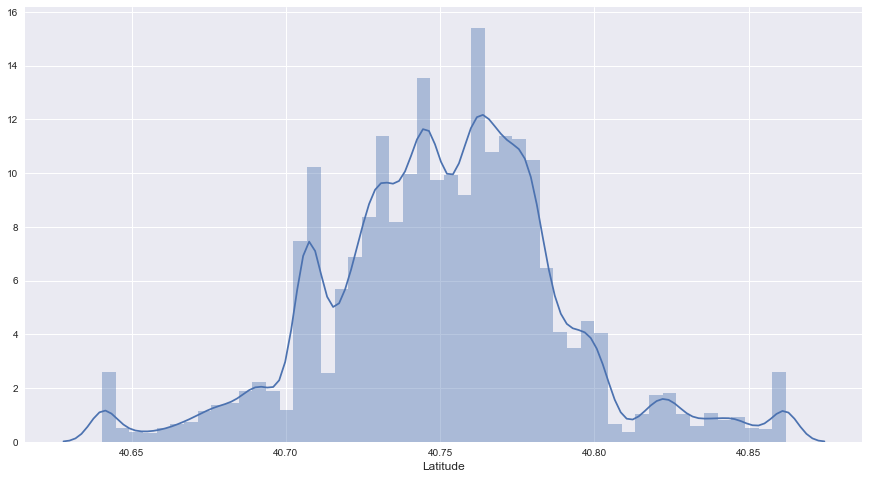

In [29]:
lower_limit = np.percentile(train["latitude"].values, 1)
upper_limit = np.percentile(train["latitude"].values, 99)

train["latitude"].ix[train["latitude"] < lower_limit] = lower_limit
train["latitude"].ix[train["latitude"] > upper_limit] = upper_limit

plt.figure(figsize=(15, 8))
sns.distplot(train["latitude"].values, bins=50, kde=True)
plt.xlabel('Latitude', fontsize=12)
plt.show()

From the graph above we see that the latitudes are ditributed in a range from 40.65 to arounf 40.85

### Analyzing Longitude

C:\Anaconda\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\Anaconda\lib\site-packages\statsmodels\nonparametric\kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


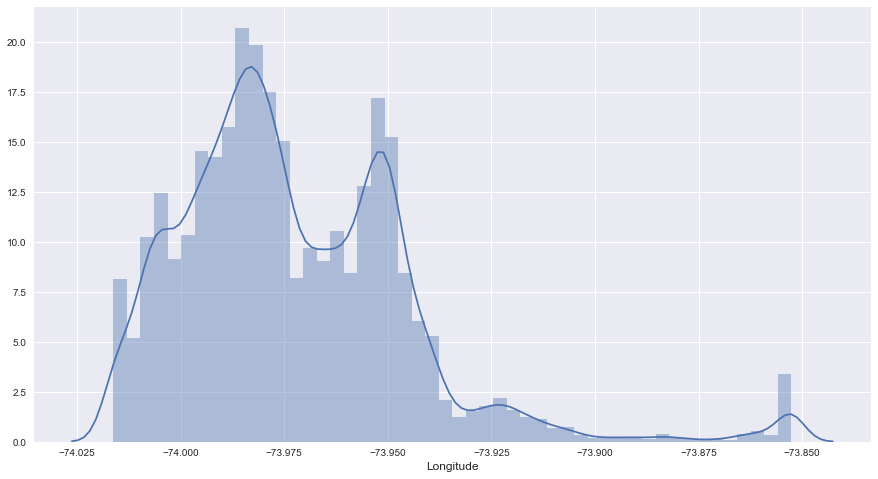

In [30]:
lower_limit = np.percentile(train["longitude"].values, 1)
upper_limit = np.percentile(train["longitude"].values, 99)

train["longitude"].ix[train["longitude"] < lower_limit] = lower_limit
train["longitude"].ix[train["longitude"] > upper_limit] = upper_limit

plt.figure(figsize=(15, 8))
sns.distplot(train["longitude"].values, bins=50, kde=True)
plt.xlabel('Longitude', fontsize=12)
plt.show()

We observe that the longitudes are distributed from -74.025 to -73.850

### Mapping with Latitudes and longitudes

In [59]:
plt.style.use('ggplot')
new_style = {'grid': False}  
matplotlib.rc('axes', **new_style)  

rcParams['figure.figsize'] = (15, 8) #Size of figure  
rcParams['figure.dpi'] = 2000

P=train.plot(kind='scatter', x='longitude', y='latitude',color='white',xlim=(-74.02, -73.85),ylim=(40.64, 40.86),
             s=.1, alpha=1, title = "basemap location plot based on latitude and longitude")

P.set_facecolor('black')


### Creating basemap for listings with high interest levels

In [62]:
plt.style.use('ggplot')
new_style = {'grid': False}  
matplotlib.rc('axes', **new_style)  

rcParams['figure.figsize'] = (15, 8)   
rcParams['figure.dpi'] = 2000

P=train.query('interest_level == "high"').plot(kind='scatter', x='longitude', y='latitude',color='white',
                                               xlim=(-74.02, -73.85),ylim=(40.64, 40.86),s=.1, alpha=1, title = "high level plot")
P.set_facecolor('black')

### Creating a basemap for medium interest levels

In [63]:
plt.style.use('ggplot')
new_style = {'grid': False}  
matplotlib.rc('axes', **new_style)  

rcParams['figure.figsize'] = (15, 8)   
rcParams['figure.dpi'] = 2000

P=train.query('interest_level == "medium"').plot(kind='scatter', x='longitude', y='latitude',color='white',
                                                 xlim=(-74.02, -73.85),ylim=(40.64, 40.86),s=.1, alpha=1, title = "medium level plot")

P.set_facecolor('black')

We plot the high and medium level location to have a look if there is any special location of these levels. But from the plot it does not show any special locations.

### Analyzing character variables

### displary_adress, description, features and street_address are the character variables. 

In [32]:
train['display_address2'] = train.display_address.map(lambda x: " ".join(x.strip("-,.$*!#&\'\t").replace("'",'').lower()\
                                                                                 .replace('street', 'st').replace('avenue', 'ave')\
                                                                         .replace('east', 'e').replace('west', 'w').split()))

In [33]:
address_value=train['display_address2'].value_counts(dropna = False)[:20]
address_value

wall st          451
broadway         443
e 34th st        441
w st             412
second ave       370
w 37th st        370
john st          346
gold st          345
york ave         316
washington st    304
w 42nd st        295
columbus ave     292
lexington ave    283
e 39th st        281
water st         280
first ave        268
e 79th st        253
e 35th st        251
w 54th st        240
thompson st      238
Name: display_address2, dtype: int64

#### We see that wall st,broadway and e 34th st are the top addresses in the data

### Creating a wordcloud for display address

In [34]:
from wordcloud import WordCloud
display_address_word = ' '.join(train['display_address2'].values.tolist())

plt.figure(figsize=(12, 9))
wordcloud = WordCloud(background_color='white', width=600, height=300, max_font_size=50).generate(display_address_word)
wordcloud.recolor(random_state=0)
plt.imshow(wordcloud)
plt.title("Wordcloud for display address", fontsize=30)
plt.axis("off")
plt.show()

### Creating wordcloud for Display address with high Interest level

#### We first create a  dataframe consisting of display addresses with high interest level

In [35]:
high=train[['display_address','interest_level']].copy()

In [36]:
high_address=high[high.interest_level=='high']
high_address

,display_address,interest_level
100004,W 13 Street,high
100044,E 38th St,high
100079,1215 Morris Avenue,high
100098,West 58th Street,high
100151,E 89 Street,high
100166,4 Ave,high
100188,Metropolitan Ave,high
100196,Schenectady Avenue,high
10020,W 167th St,high
100209,14th Street,high


In [37]:
high_address['display_address2'] = high_address.display_address.map(lambda x: " ".join(x.strip("-,.$*!#&\'\t").replace("'",'').lower()\
                                                                         .replace('street', 'st').replace('avenue', 'ave')\
                                                                         .replace('east', 'e').replace('west', 'w').split()))
high_address['display_address2'].value_counts(dropna = True)[:20]

C:\Anaconda\lib\site-packages\ipykernel\__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


broadway         39
w st             36
john st          33
thompson st      32
w 37th st        29
e 34th st        28
e 12th st        27
e 35th st        27
second ave       25
gold st          24
washington st    23
e 25th st        23
e 14th st        22
e 39th st        22
                 21
w 34th st        19
e 4th st         19
water st         19
lexington ave    19
main st          19
Name: display_address2, dtype: int64

#### We see that the address like broadway,w st and john st have high interest levels and have highest number of listings

In [38]:
display_address_high2 = ' '.join(high_address.display_address.map(lambda x: '_'.join(x.strip().split(" "))))

plt.figure(figsize=(12, 9))
wordcloud = WordCloud(background_color='white', width=600, height=300, max_font_size=50, max_words=40).generate(display_address_high2)
wordcloud.recolor(random_state=0)
plt.imshow(wordcloud)
plt.title("Wordcloud for display address with high level", fontsize=30)
plt.axis("off")
plt.show()

### Now Creating a word cloud for display address with Medium interest level

#### first we create a new dataframe consisting of display address and medium 

In [39]:
medium=train[['display_address','interest_level']].copy()
medium_address=medium[medium.interest_level=='medium']
medium_address

,display_address,interest_level
10,Metropolitan Avenue,medium
100014,West 18th Street,medium
100026,Hamilton Terrace,medium
100051,East 34th Street,medium
100063,"E 30th St,",medium
10007,W 18 St.,medium
100075,E 81st St.,medium
100083,250 West 88th Street,medium
100084,W 93 St.,medium
10010,W 34 St.,medium


In [40]:
medium_address['display_address2'] = medium_address.display_address.map(lambda x: " ".join(x.strip("-,.$*!#&\'\t").replace("'",'').lower()\
                                                                         .replace('street', 'st').replace('avenue', 'ave')\
                                                                         .replace('east', 'e').replace('west', 'w').split()))
medium_address['display_address2'].value_counts(dropna = False)[:20]

C:\Anaconda\lib\site-packages\ipykernel\__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


e 34th st        121
broadway         104
w st             100
wall st           95
e 35th st         93
john st           92
w 37th st         84
e 95th st         84
w 42nd st         81
washington st     76
w 34th st         72
2nd ave           72
water st          72
gold st           69
columbus ave      68
second ave        64
thompson st       62
e 39th st         61
e 79th st         61
w 54th st         61
Name: display_address2, dtype: int64

We see that e 34th st,broadway and w st have teh highest number of listings with medium interest levels

In [41]:
display_address_medium2 = ' '.join(medium_address.display_address.map(lambda x: '_'.join(x.strip().split(" "))))

plt.figure(figsize=(12, 9))
wordcloud = WordCloud(background_color='white', width=600, height=300, max_font_size=50, max_words=40).generate(display_address_medium2)
wordcloud.recolor(random_state=0)
plt.imshow(wordcloud)
plt.title("Wordcloud for display address with high level", fontsize=30)
plt.axis("off")
plt.show()

### Now creating a word cloud for display address with low interest levels

In [64]:
low=train[['display_address','interest_level']].copy()
low_address=low[low.interest_level=='low']
low_address

,display_address,interest_level
10000,Columbus Avenue,low
100007,East 49th Street,low
100013,West 143rd Street,low
100016,West 107th Street,low
100020,West 21st Street,low
100027,522 E 11th,low
100030,York Avenue,low
10004,W. 173rd Street,low
100048,West 63rd Street,low
10005,East 56th St..,low


In [43]:
low_address['display_address2'] = low_address.display_address.map(lambda x: " ".join(x.strip("-,.$*!#&\'\t").replace("'",'').lower()\
                                                                         .replace('street', 'st').replace('avenue', 'ave')\
                                                                         .replace('east', 'e').replace('west', 'w').split()))
low_address['display_address2'].value_counts(dropna = False)[:20]

C:\Anaconda\lib\site-packages\ipykernel\__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


wall st           344
broadway          300
e 34th st         292
second ave        281
w st              276
york ave          268
w 37th st         257
gold st           252
john st           221
first ave         211
columbus ave      207
washington st     205
w 42nd st         204
lexington ave     204
e 39th st         198
w end ave         195
christopher st    192
e 82nd st         191
water st          189
e 72nd st         188
Name: display_address2, dtype: int64

In [44]:
display_address_low2 = ' '.join(low_address.display_address.map(lambda x: '_'.join(x.strip().split(" "))))

plt.figure(figsize=(12, 9))
wordcloud = WordCloud(background_color='white', width=600, height=300, max_font_size=50, max_words=40).generate(display_address_low2)
wordcloud.recolor(random_state=0)
plt.imshow(wordcloud)
plt.title("Wordcloud for display address with low level", fontsize=30)
plt.axis("off")
plt.show()

#### Analyzing Features

In [47]:
feature_list = train.features.values.tolist()
feature_list_all = [item for sublist in feature_list for item in sublist]
feature_list_all_norm = map(lambda x: "_".join(x.strip().split(" ")), feature_list_all)
feature_list_all_norm_ = " ".join(feature_list_all_norm)

plt.figure(figsize=(12, 9))
wordcloud = WordCloud(background_color='white', width=600, height=300, max_font_size=50, max_words=40).generate(feature_list_all_norm_)
wordcloud.recolor(random_state=0)
plt.imshow(wordcloud)
plt.title("Wordcloud for features", fontsize=30)
plt.axis("off")
plt.show()

In [48]:
from nltk import FreqDist

fdist1 = FreqDist(feature_list_all_norm_.split())

# show most 10 frequent word in the text
print (fdist1.most_common(10))

[('Elevator', 25915), ('Cats_Allowed', 23540), ('Hardwood_Floors', 23527), ('Dogs_Allowed', 22035), ('Doorman', 20898), ('Dishwasher', 20426), ('No_Fee', 18062), ('Laundry_in_Building', 16344), ('Fitness_Center', 13252), ('Pre-War', 9148)]


#### We find that the most popular features are Elevator,Cats_allowed,Hardwood_floors , Dogs_Allowed .....